# Benchmarking spatial mapping of cell types in the LN

## Loading packages

In [1]:
import sys
import pickle
import scanpy as sc
import anndata
import numpy as np
import os
import pandas as pd

sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/')
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/cell2location_dev/')

import cell2location

import matplotlib as mpl
from matplotlib import pyplot as plt

# scanpy prints a lot of warnings
import warnings
warnings.filterwarnings('ignore')

def select_slide(adata, s, s_col='sample'):
    r""" This function selects the data for one slide from the spatial anndata object.
    
    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param s_col: column in adata.obs listing experiment name for each location
    """
    
    slide = adata[adata.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}
    
    return slide

In [2]:
cell2location

<module 'cell2location' from '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/cell2location/__init__.py'>

## 1. Loading cell2location results <a name="loading"></a>

In [3]:
# read a previously trained LocationModel
sp_data_folder = '/nfs/team205/vk7/sanger_projects/large_data/gut_kj_re/Visium/'
results_folder = '/nfs/team205/vk7/sanger_projects/collaborations/fetal_gut_mapping/results/'
sp_results_folder = f'{results_folder}'
sc_results_folder = f'{results_folder}regression_model/'

# Set paths to data and results used through the document:
sp_data_folder = '/nfs/team205/vk7/sanger_projects/large_data/gut_kj_re/oxford_visium/'
results_folder = '/nfs/team205/vk7/sanger_projects/collaborations/fetal_gut_mapping/results/'
annotations_folder = '/nfs/team205/vk7/sanger_projects/collaborations/fetal_gut_mapping/results/tissue_annotation/oxford/'
sc_results_folder = '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/gut/'

regression_model_output = 'v1_ye_signatures_lr0002_Adam'
reg_path = f'{results_folder}regression_model/{regression_model_output}/'
## snRNAseq reference (raw counts)
adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')

run_name = 'c2l_v3_nonamortised_fulldata_epochs20k_lr0002_Adam_oxford_adult_paed_ref_signatures_N25_alphatest20'
scvi_run_name = f'{results_folder}/{run_name}'

# path for saving figures
fig_path = f'{results_folder}{run_name}/plots/figures/'
sc_figpath = sc.settings.figdir
sc.settings.figdir = f'{fig_path}'

sp_data_file = f'{results_folder}{run_name}/sp.h5ad'
adata_vis = anndata.read(sp_data_file)

# add 5% quantile, representing confident cell abundance, 'at least this amount is present', 
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

In [4]:
# export estimated expression in each cluster
if 'means_per_cluster_mu_fg' in adata_snrna_raw.varm.keys():
    inf_aver = adata_snrna_raw.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}' 
                                    for i in adata_snrna_raw.uns['mod']['factor_names']]].copy()
else:
    inf_aver = adata_snrna_raw.var[[f'means_per_cluster_mu_fg_{i}' 
                                    for i in adata_snrna_raw.uns['mod']['factor_names']]].copy()
inf_aver.columns = adata_snrna_raw.uns['mod']['factor_names']
inf_aver.iloc[0:5, 0:5]

,Activated CD4 T,Activated CD8 T,Adult Glia,BEST2+ Goblet cell,BEST4+ epithelial
ENSG00000187634,0.000475,0.000341,0.008211,0.001663,0.001148
ENSG00000188976,0.056281,0.082341,0.061379,0.256258,0.149516
ENSG00000187583,0.002949,0.016270,0.003423,0.007914,0.001061
ENSG00000188290,0.041080,0.058555,0.128032,0.130205,1.816961
ENSG00000187608,0.123889,0.235275,0.197328,0.110768,0.701299


## 2. Generating gold standard annotations results <a name="loading2"></a>

Trying to set attribute `.uns` of view, copying.


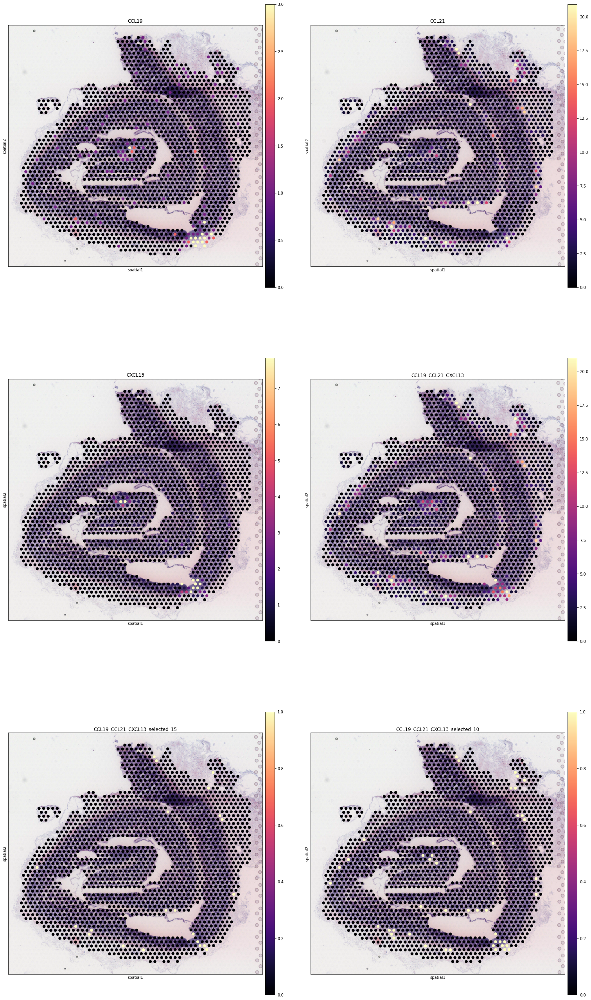

In [5]:
slide = select_slide(adata_vis, 'A2')

with mpl.rc_context({'figure.figsize': [12,14],
                     'axes.facecolor': 'black'}):
    slide.obs["CCL19_CCL21_CXCL13"] = slide[:,slide.var['SYMBOL'].isin(["CCL19", "CCL21", "CXCL13"])].X.sum(1)
    slide.obs["CCL19_CCL21_CXCL13_selected_15"] = np.array(slide.obs["CCL19_CCL21_CXCL13"] > 14).astype(float)
    slide.obs["CCL19_CCL21_CXCL13_selected_10"] = np.array(slide.obs["CCL19_CCL21_CXCL13"] > 9).astype(float)
    sc.pl.spatial(slide, 
                  color=["CCL19", "CCL21", "CXCL13", "CCL19_CCL21_CXCL13", 
                         'CCL19_CCL21_CXCL13_selected_15', 'CCL19_CCL21_CXCL13_selected_10'], #img_key=None, size=1,
                  vmin=0, cmap='magma', vmax='p99.5',
                  ncols=2,
                  gene_symbols='SYMBOL'
                 )
s59_l = slide.obs["CCL19_CCL21_CXCL13_selected_10"]

Trying to set attribute `.uns` of view, copying.


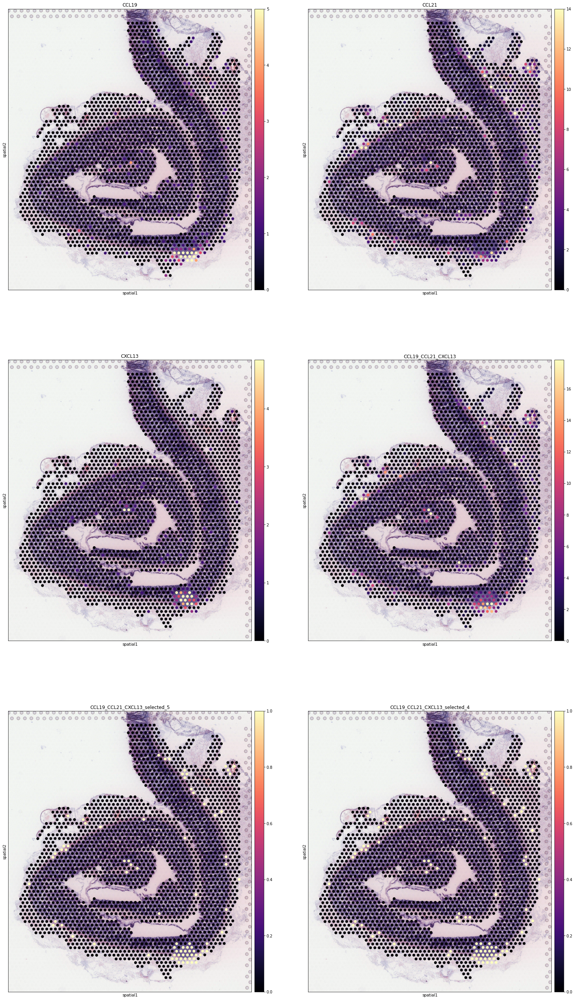

In [6]:
slide = select_slide(adata_vis, 'A1')

with mpl.rc_context({'figure.figsize': [12,14],
                     'axes.facecolor': 'black'}):
    slide.obs["CCL19_CCL21_CXCL13"] = slide[:,slide.var['SYMBOL'].isin(["CCL19", "CCL21", "CXCL13"])].X.sum(1)
    slide.obs["CCL19_CCL21_CXCL13_selected_5"] = np.array(slide.obs["CCL19_CCL21_CXCL13"] > 4).astype(float)
    slide.obs["CCL19_CCL21_CXCL13_selected_4"] = np.array(slide.obs["CCL19_CCL21_CXCL13"] > 3).astype(float)
    sc.pl.spatial(slide, 
                  color=["CCL19", "CCL21", "CXCL13", "CCL19_CCL21_CXCL13", 
                         'CCL19_CCL21_CXCL13_selected_5', 'CCL19_CCL21_CXCL13_selected_4'], #img_key=None, size=1,
                  vmin=0, cmap='magma', vmax='p99.5',
                  ncols=2,
                  gene_symbols='SYMBOL'
                 )
a1_l = slide.obs["CCL19_CCL21_CXCL13_selected_5"]

### Add lymphoid structure gold standard

Trying to set attribute `.uns` of view, copying.


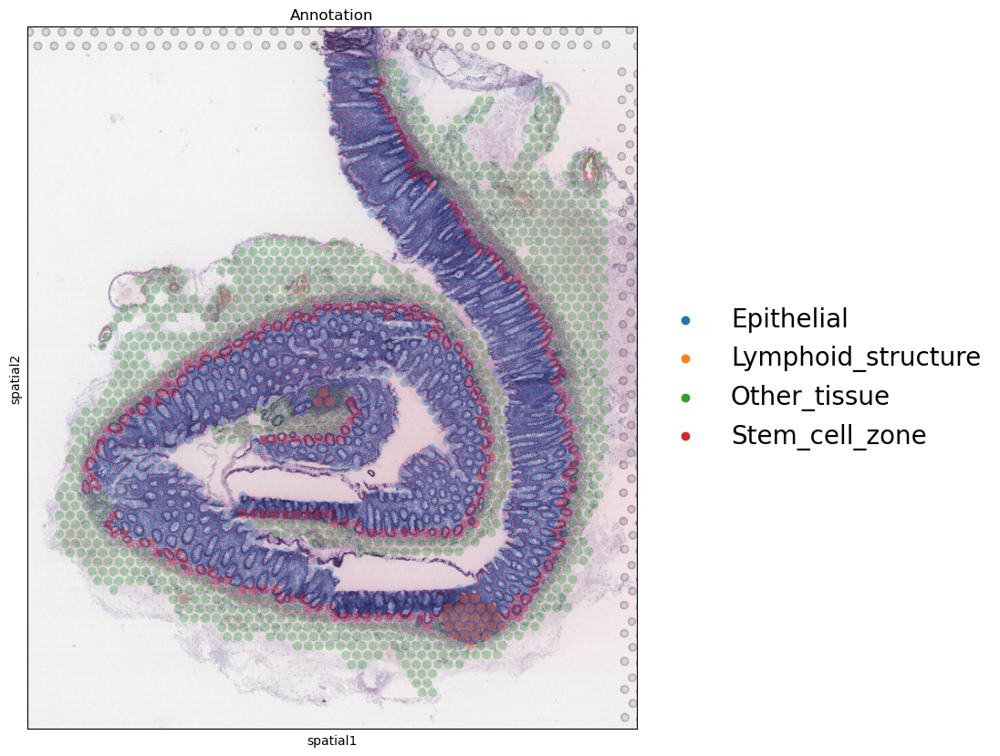

In [7]:
slide = select_slide(adata_vis, 'A1')

mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text

with mpl.rc_context({'figure.figsize': (10, 10), 'axes.facecolor': "black"}):
    fig=sc.pl.spatial(slide, cmap='magma',
                  color=['Annotation'], ncols=4, 
                  size=1.3, img_key='hires', 
                  alpha_img=1, alpha=0.3,
                  frameon=True, legend_fontsize=20,
                  #crop_coord=[crop_x[0]] + [crop_x[1]] 
                  #    + [crop_y[1]] + [crop_y[0]],
                  vmin=0, vmax='p99.5', #save='benchmark_supervised_region.pdf',,
                  return_fig=True, show=False,
                  #palette=sc.pl.palettes.default_102
                 )
    #fig[0].savefig(f'{fig_path}benchmark_supervised_region.pdf',
    #                bbox_inches='tight', facecolor='white')
    fig
    plt.show()

Trying to set attribute `.uns` of view, copying.


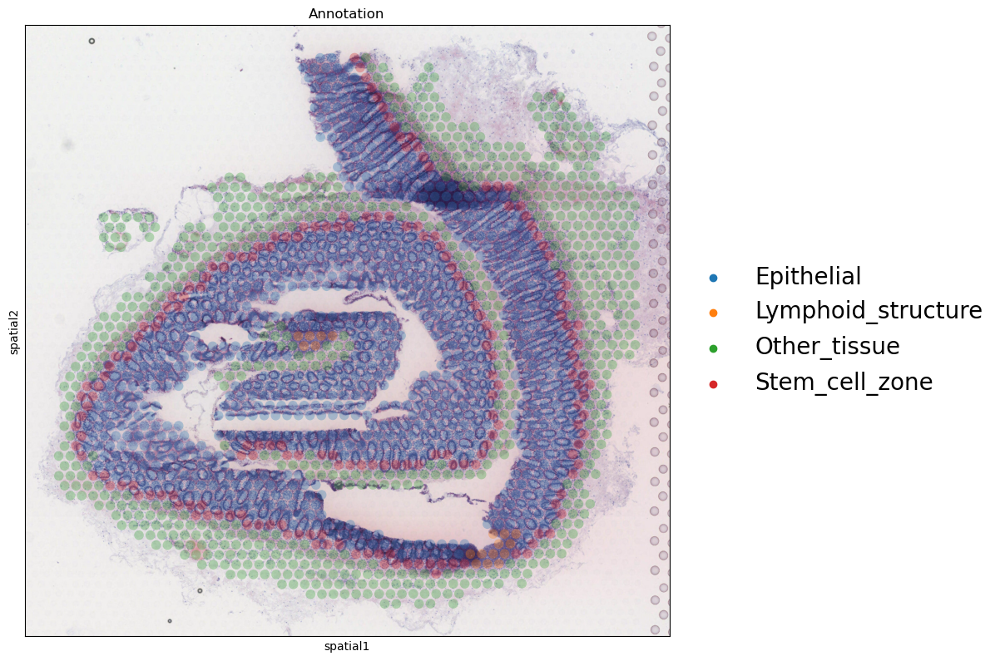

In [8]:
slide = select_slide(adata_vis, 'A2')

mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text

with mpl.rc_context({'figure.figsize': (10, 10), 'axes.facecolor': "black"}):
    fig=sc.pl.spatial(slide, cmap='magma',
                  color=['Annotation'], ncols=4, 
                  size=1.3, img_key='hires', 
                  alpha_img=1, alpha=0.3,
                  frameon=True, legend_fontsize=20,
                  #crop_coord=[crop_x[0]] + [crop_x[1]] 
                  #    + [crop_y[1]] + [crop_y[0]],
                  vmin=0, vmax='p99.5', #save='benchmark_supervised_region.pdf',,
                  return_fig=True, show=False,
                  #palette=sc.pl.palettes.default_102
                 )
    #fig[0].savefig(f'{fig_path}benchmark_supervised_region.pdf',
    #                bbox_inches='tight', facecolor='white')
    fig
    plt.show()

In [9]:
# region annotations for each cell type
gold_standard_dict = {
    'Cycling B cell': 'Lymphoid_structure',
    'Naive B': 'Lymphoid_structure',
    'SELL+ CD8 T': 'Lymphoid_structure',
    'SELL+ CD4 T': 'Lymphoid_structure',
    'Treg': 'Lymphoid_structure',
    'T reticular': 'Lymphoid_structure',
    'cDC2': 'Lymphoid_structure',
    'cDC1': 'Lymphoid_structure',
    'Lymphoid DC': 'Lymphoid_structure',
    'DZ GC cell': 'Lymphoid_structure',
    'Tfh': 'Lymphoid_structure',
    'GC B cell': 'Lymphoid_structure',
    'FDC': 'Lymphoid_structure',
    'LZ GC cell': 'Lymphoid_structure',
    'STAT1+ Naive B': 'Lymphoid_structure',
    'FCRL4+ Memory B': 'Lymphoid_structure',
    'Memory B': 'Lymphoid_structure',
    'Activated CD4 T': 'Lymphoid_structure',
    'CD8 Tmem': 'Lymphoid_structure',
} 
gold_standard = pd.DataFrame(gold_standard_dict, index=['label']).T
gold_standard.index = [f'gold_standard_{i}' for i in gold_standard.index]

for ct in gold_standard.index:
    adata_vis.obs[ct] = adata_vis.obs['Annotation'].isin([gold_standard.loc[ct, 'label']]).astype(float)
    
adata_vis.obs[gold_standard.index]

,gold_standard_Cycling B cell,gold_standard_Naive B,gold_standard_SELL+ CD8 T,gold_standard_SELL+ CD4 T,gold_standard_Treg,gold_standard_T reticular,gold_standard_cDC2,gold_standard_cDC1,gold_standard_Lymphoid DC,gold_standard_DZ GC cell,gold_standard_Tfh,gold_standard_GC B cell,gold_standard_FDC,gold_standard_LZ GC cell,gold_standard_STAT1+ Naive B,gold_standard_FCRL4+ Memory B,gold_standard_Memory B,gold_standard_Activated CD4 T,gold_standard_CD8 Tmem
spot_id,,,,,,,,,,,,,,,,,,,
A1_AAACAAGTATCTCCCA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A1_AAACAGAGCGACTCCT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A1_AAACATTTCCCGGATT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A1_AAACCACTACACAGAT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A1_AAACCCGAACGAAATC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
A2_TTGTGTATGCCACCAA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A2_TTGTGTTTCCCGAAAG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A2_TTGTTGTGTGTCAAGA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [10]:
ct_counts = adata_snrna_raw.obs['Integrated_05'].value_counts()
ct_proportion = ct_counts / ct_counts.sum()
ct_counts[gold_standard_dict.keys()], ct_proportion[gold_standard_dict.keys()]

(Cycling B cell     1800
 Naive B            3513
 SELL+ CD8 T         446
 SELL+ CD4 T        2680
 Treg               2325
 T reticular         161
 cDC2                539
 cDC1                139
 Lymphoid DC          53
 DZ GC cell          796
 Tfh                 842
 GC B cell          1061
 FDC                 183
 LZ GC cell          531
 STAT1+ Naive B       23
 FCRL4+ Memory B     176
 Memory B           4397
 Activated CD4 T    3296
 CD8 Tmem           1275
 Name: Integrated_05, dtype: int64,
 Cycling B cell     0.011696
 Naive B            0.022826
 SELL+ CD8 T        0.002898
 SELL+ CD4 T        0.017414
 Treg               0.015107
 T reticular        0.001046
 cDC2               0.003502
 cDC1               0.000903
 Lymphoid DC        0.000344
 DZ GC cell         0.005172
 Tfh                0.005471
 GC B cell          0.006894
 FDC                0.001189
 LZ GC cell         0.003450
 STAT1+ Naive B     0.000149
 FCRL4+ Memory B    0.001144
 Memory B           0.028

### Add epithelial/SMC gold standard

In [11]:
# region annotations for each cell type
gold_standard_epi = {
    #'mLTo': 'Lymphoid_structure',
    #'LTi-like ILC3': 'Lymphoid_structure',
    #'LTi-like NK/T': 'Lymphoid_structure',
    #'ILCP': 'Lymphoid_structure',
    #'Immature B': 'Lymphoid_structure',
    #'NK cell': 'Lymphoid_structure',
    #'SELL+ CD4 T': 'Lymphoid_structure',
    #'SELL+ CD8 T': 'Lymphoid_structure',
    
    
    'Paneth': 'Crypts',
    'Stem cells': 'Crypts',
    'TA': 'Crypts',
    'Enterocyte': 'Other_epithelial',
    'BEST4+ epithelial': 'Other_epithelial',
    'Goblet cell': 'Other_epithelial',
    'Tuft': 'Other_epithelial',
} 

ct_counts = adata_snrna_raw.obs['Integrated_05'].value_counts()
ct_proportion = ct_counts / ct_counts.sum()
ct_counts[gold_standard_epi.keys()], ct_proportion[gold_standard_epi.keys()]

(Paneth                2861
 Stem cells            1340
 TA                   44084
 Enterocyte           15340
 BEST4+ epithelial     3886
 Goblet cell           1788
 Tuft                   660
 Name: Integrated_05, dtype: int64,
 Paneth               0.018590
 Stem cells           0.008707
 TA                   0.286444
 Enterocyte           0.099674
 BEST4+ epithelial    0.025250
 Goblet cell          0.011618
 Tuft                 0.004288
 Name: Integrated_05, dtype: float64)

## Compare methods using PR-curves

In [12]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score

import matplotlib as mpl
from matplotlib import pyplot as plt
import numpy as np
from scipy import interpolate

from functools import partial
from itertools import cycle

def swap_return_order(f, order, *args, **kwargs):
    result = f(*args, **kwargs)
    return [result[i] for i in order]


with plt.style.context('seaborn'):
    seaborn_colors = mpl.rcParams['axes.prop_cycle'].by_key()['color']



def compute_curve(pos_cell_count, infer_cell_proportions, mode='macro', curve='AUC'):
    r"""
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    """
    predictor = infer_cell_proportions.values + np.random.gamma(20, 1e-12, infer_cell_proportions.shape)
    
    X = dict()
    Y = dict()
    scores = dict()
    
    if curve == 'ROC':
        # in this case X is FPR and Y is TPR
        curve_function = partial(swap_return_order, roc_curve, [1, 0, 2])
        score_function = roc_auc_score
        
    elif curve == 'PR':
        # in this case X is recall and Y is precision
        curve_function = precision_recall_curve
        score_function = average_precision_score
        
    for i, c in enumerate(infer_cell_proportions.columns):
        Y[c], X[c], _ = curve_function(pos_cell_count[:, i], predictor[:, i])
        scores[c] = score_function(pos_cell_count[:, i], predictor[:, i], average=mode)

    scores["averaged"] = score_function(pos_cell_count, predictor, average=mode)
    
    if mode == 'micro':
        Y["averaged"], X["averaged"], _ = curve_function(pos_cell_count.ravel(), predictor.ravel())

    elif mode == 'macro':
        Ys = []
        x_grid = np.linspace(0, 1, 2000)
        for i, c in enumerate(infer_cell_proportions.columns):
            f = interpolate.interp1d(X[c], Y[c])
            y_interp = f(x_grid)
            Ys.append(y_interp)

        X["averaged"] = x_grid
        Y['averaged'] = np.mean(Ys, axis=0)
    return X, Y, scores 

compute_roc = partial(compute_curve, curve='ROC')
compute_precision_recall = partial(compute_curve, curve='PR')

def plot_curve(pos_cell_count, infer_cell_proportions,
                          title='', individual_cell_types=True,
                          mode='macro', curve='PR', 
                          ax=None, save=None, color='navy', lw=2):
    r""" Plot precision-recall curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    :param title: plot title
    :param iso_f1_curves: plot iso curves for F1 score?
    :param individual_cell_types: show precision-recall curves for each cell type?
    """
    
    ### calculating ###
    if curve == 'PR':
        xlabel = 'Recall'
        ylabel = 'Precision'
        
    elif curve == 'ROC':
        xlabel = 'FPR'
        ylabel = 'TPR'
    
    X, Y, scores = compute_curve(pos_cell_count, infer_cell_proportions, mode=mode, curve=curve)
    
    ### plotting ###
    if ax is None:
        ax = plt.gca()
        
    colors = cycle(['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal'])

    lines = []
    labels = []
    
    l = ax.plot(X["averaged"], Y["averaged"], color=color, lw=lw)
    lines.append(l[0])
    labels.append(f'{mode}-average {curve} ({curve} score = {scores["averaged"] :.2f})')

    if individual_cell_types:
        for i, color in zip(infer_cell_proportions.columns, colors):
            l = ax.plot(X[i], Y[i], color='gold', lw=1)
        lines.append(l[0])
        labels.append(f'{curve} for individual cell types')
        
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.legend(lines, labels, loc=(0, -.37), prop=dict(size=8))

    if save is not None:
        plt.savefig(save)
        
    return ax, scores
    

plot_roc = partial(plot_curve, curve='ROC')
plot_precision_recall = partial(plot_curve, curve='PR')


def compare_curve(pos_cell_count, infer_cell_proportions,
                             method_title, title='',
                             legend_loc=(0, -.37),
                             colors=sc.pl.palettes.default_102,
                             mode='macro', curve='PR', lw=2,
                             font_size=12):
    
    r""" Plot precision-recall/ROC curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells), 
                                        list of inferred parameters for several methods
    :param method_title: title for each infer_cell_proportions
    :param title: plot title
    """
    # setup plot details
    from itertools import cycle
    colors = cycle(colors)
    lines = []
    labels = []
    score = {}
    
    ### plotting ###
    for i, color in zip(range(len(infer_cell_proportions)), colors):
        
        ax, score = plot_curve(pos_cell_count, infer_cell_proportions[i], color=color, 
                               individual_cell_types=False, curve=curve, mode=mode, lw=lw)
        lines.append(ax.lines[-1])
        labels.append(method_title[i] + '(' + curve + ' score = {0:0.2f})'
                      ''.format(score["averaged"]))
        score[method_title[i]] = score["averaged"]


    fig = plt.gcf()
    fig.subplots_adjust(bottom=0.25)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.title(title)
    if legend_loc is not None:
        plt.legend(lines, labels, loc=legend_loc, prop=dict(size=font_size))

    #plt.show()
    return score

compare_roc = partial(compare_curve, curve='ROC')
compare_precision_recall = partial(compare_curve, curve='PR')

In [13]:
from re import sub
col_ind = [sub('gold_standard_','',i) for i in gold_standard.index]

In [14]:
results_folder_st = f'{results_folder}oxford/rctd/'
RCTD = pd.read_csv(f'{results_folder_st}results_selected_weights_76clusters.csv',
                   index_col='spot')
adata_vis = adata_vis[adata_vis.obs_names.isin(RCTD.index),:]

# compute cell proportions
RCTD = (RCTD.T / RCTD.sum(1)).T
RCTD = RCTD.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'RCTD_{i}' for i in RCTD.columns]] = RCTD.values

results = [RCTD[col_ind]]
names = ['RCTD']

Trying to set attribute `.obs` of view, copying.


In [15]:
results_folder_st = f'{results_folder}oxford/scvi_stereoscope_selected_optimised_long/'
scvi_stereoscope = anndata.read(f'{results_folder_st}/stmodel/sp_40k_released.h5ad')

scvi_stereoscope = scvi_stereoscope.obsm['decomposition'].copy()
scvi_stereoscope = (scvi_stereoscope.T / scvi_stereoscope.sum(1)).T
scvi_stereoscope = scvi_stereoscope.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'scVI_Stereoscope_{i}' for i in scvi_stereoscope.columns]] = scvi_stereoscope.values

results = results + [scvi_stereoscope[col_ind]]
names = names + ['scVI_Stereoscope']

In [16]:
results_folder_st = f'{results_folder}oxford/seurat/'

seurat = pd.read_csv(f'{results_folder_st}results_selected_76clusters_pca.csv', index_col=0)
seurat = seurat.drop(columns=['predicted.id', 'spot', 'prediction.score.max'])

from re import sub
seurat.columns = [sub('prediction\.score\.', '', i) for i in seurat.columns]

def remove_special_characters(df, special_list=[' ', '\(', '\)', '\+', '\\\\', '/', '-', ';'],
                              replace='.'):
    from re import sub
    for s in special_list:
        df = [sub(s, replace, c) for c in df]
            
    return df

inf_aver_copy = adata_vis.uns['mod']['factor_names'].copy()
inf_aver_copy = remove_special_characters(inf_aver_copy)

seurat = seurat[inf_aver_copy]
seurat.columns = adata_vis.uns['mod']['factor_names']

# compute cell proportions
seurat = (seurat.T / seurat.sum(1)).T
seurat = seurat.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'Seurat_{i}' for i in seurat.columns]] = seurat.values

results = results + [seurat[col_ind]]
names = names + ['Seurat']

In [17]:
results_folder_st = f'{results_folder}oxford/autogenes_models/'
nnls = pd.read_csv(f'{results_folder_st}coef_nnls_selected_seed.csv', index_col=0).T

# compute cell proportions
nnls = (nnls.T / nnls.sum(1)).T
nnls[nnls.isna()] = 0

nnls = nnls.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'NNSL_{i}' for i in nnls.columns]] = nnls.values

results = results + [nnls[col_ind]]
names = names + ['NNSL']

In [18]:
pos_cell_count = adata_vis.obs[gold_standard.index].values
pos_cell_count_df = adata_vis.obs[gold_standard.index]

cell2loc = adata_vis.obs[adata_vis.uns['mod']['factor_names']]
cell2loc = (cell2loc.T / cell2loc.sum(1)).T

adata_vis.obs[[f'cell2location_{i}' for i in cell2loc.columns]] = cell2loc.values

results =  [cell2loc[col_ind]] + results
names = ['cell2location'] + names

In [19]:
names

['cell2location', 'RCTD', 'scVI_Stereoscope', 'Seurat', 'NNSL']

In [20]:
fig_path

'/nfs/team205/vk7/sanger_projects/collaborations/fetal_gut_mapping/results/c2l_v3_nonamortised_fulldata_epochs20k_lr0002_Adam_oxford_adult_paed_ref_signatures_N25_alphatest20/plots/figures/'

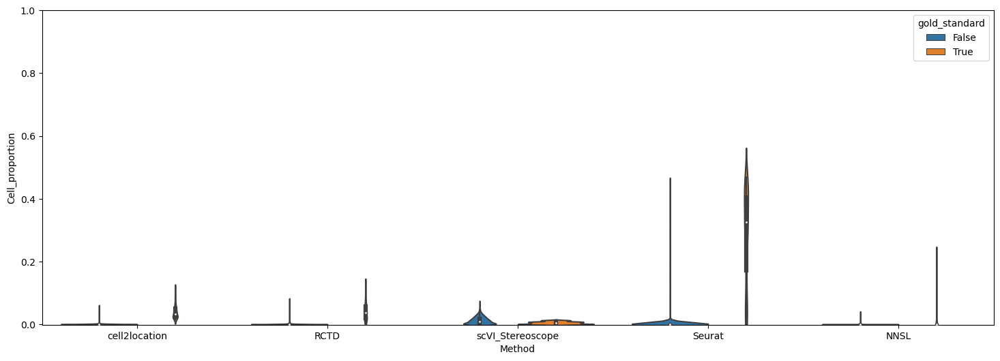

,cell2location,RCTD,scVI_Stereoscope,Seurat,NNSL
pvalue,0.000000,0.000000,0.999968,0.000000,0.000000
mean_GC,0.039076,0.040850,0.004973,0.283809,0.010686
mean_nonGC,0.000727,0.000548,0.011708,0.001458,0.000017
fold_change,53.730522,74.593651,0.424787,194.663314,611.739639
mean_greater_than_0.055_GC,0.200000,0.266667,0.000000,0.844444,0.088889
mean_greater_than_0.055_nonGC,0.000527,0.000264,0.001581,0.005534,0.000000
sum_greater_than_0.055_GC,9.000000,12.000000,0.000000,38.000000,4.000000
sum_greater_than_0.055_nonGC,2.000000,1.000000,6.000000,21.000000,0.000000
greater_than_0.055_FC,379.500000,1012.000000,0.000000,152.603175,inf


In [21]:
# save combined object
fig2k = pd.DataFrame()
selected = ['FDC']
fig2k['gold_standard'] = pos_cell_count[:, results[0].columns.isin(selected)].flatten()

for i,n in enumerate(names):
    fig2k[n] = results[i].values[:, results[0].columns.isin(selected)].flatten()
    
fig2k_melt = fig2k.melt(id_vars='gold_standard', var_name='Method', value_name='Cell_proportion')

plt.figure(figsize=(18, 6))
import seaborn as sns
#ax = sns.swarmplot(x="Method", y="Cell_proportion", hue="gold_standard", data=fig2k_melt, dodge=True,
#                  hue_order=[False, True], size=2.5, color='grey')

ax = sns.violinplot(x="Method", y="Cell_proportion", hue="gold_standard", data=fig2k_melt, dodge=True,
                  hue_order=[False, True], inner='box', bw=0.3)
plt.ylim(-0.001, 1.001);
plt.show()

import scipy
ttest = {n: [scipy.stats.ttest_ind(fig2k.loc[fig2k['gold_standard'] != True, n].values, 
                      fig2k.loc[fig2k['gold_standard'] == True, n].values,
                       alternative='less')[1], 
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values),
             np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values), 
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values) \
             / np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values), 
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values > 0.055),
             np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values > 0.055),
             np.sum(fig2k.loc[fig2k['gold_standard'] == True, n].values > 0.055),
             np.sum(fig2k.loc[fig2k['gold_standard'] != True, n].values > 0.055),
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values > 0.055)\
             / np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values > 0.055)]
            for n in names}
ttest = pd.DataFrame(ttest, index=['pvalue', 'mean_GC', 'mean_nonGC', 'fold_change', 
                           'mean_greater_than_0.055_GC', 'mean_greater_than_0.055_nonGC',
                           'sum_greater_than_0.055_GC', 'sum_greater_than_0.055_nonGC',
                           'greater_than_0.055_FC']).round(10)
ttest

In [22]:
p_sel = pd.crosstab(fig2k['gold_standard'], fig2k['cell2location'] > 0.055, margins=True)
p_sel, p_sel[True][1.0] / p_sel['All'][1.0], p_sel[True][1.0] / p_sel[True]['All']

(cell2location  False  True   All
 gold_standard                   
 0.0             3793     2  3795
 1.0               36     9    45
 All             3829    11  3840,
 0.2,
 0.8181818181818182)

In [23]:
sum_ratio = (ttest.loc['sum_greater_than_0.055_nonGC'])/ttest.loc['sum_greater_than_0.055_GC']
sum_ratio

cell2location       0.222222
RCTD                0.083333
scVI_Stereoscope         inf
Seurat              0.552632
NNSL                0.000000
dtype: float64

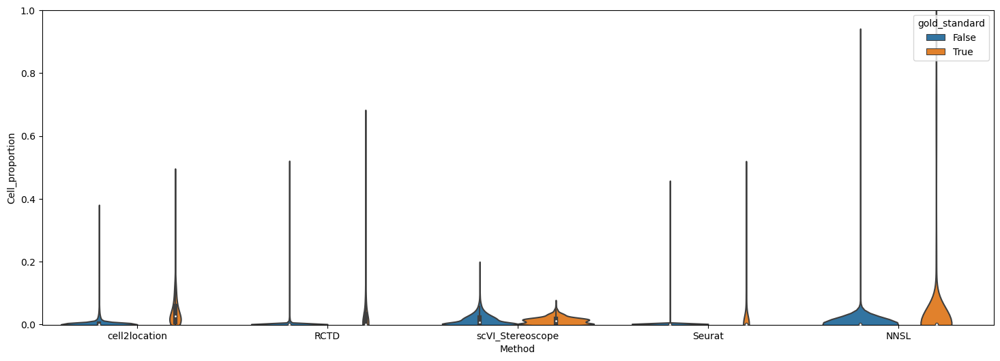

,cell2location,RCTD,scVI_Stereoscope,Seurat,NNSL
pvalue,0.000000,0.000000,0.983260,0.000000,0.000000
mean_GC,0.044873,0.033901,0.012669,0.032121,0.044124
mean_nonGC,0.004813,0.001353,0.013966,0.000153,0.011965
fold_change,9.323870,25.047189,0.907171,209.915295,3.687668
mean_greater_than_0.031_GC,0.445614,0.260819,0.077193,0.194152,0.085380
mean_greater_than_0.031_nonGC,0.035434,0.009611,0.148145,0.001290,0.034075
sum_greater_than_0.031_GC,381.000000,223.000000,66.000000,166.000000,73.000000
sum_greater_than_0.031_nonGC,2555.000000,693.000000,10682.000000,93.000000,2457.000000
greater_than_0.031_FC,12.575734,27.137566,0.521063,150.530466,2.505630


In [24]:
# save combined object
fig2k = pd.DataFrame()
selected = results[0].columns#['T_CD4+_TfH_GC', 'B_GC_prePB', 'B_GC_DZ']
fig2k['gold_standard'] = pos_cell_count[:, results[0].columns.isin(selected)].flatten()

for i,n in enumerate(names):
    fig2k[n] = results[i].values[:, results[0].columns.isin(selected)].flatten()
    
fig2k_melt = fig2k.melt(id_vars='gold_standard', var_name='Method', value_name='Cell_proportion')

plt.figure(figsize=(18, 6))
import seaborn as sns
#ax = sns.swarmplot(x="Method", y="Cell_proportion", hue="gold_standard", data=fig2k_melt, dodge=True,
#                  hue_order=[False, True], size=2.5, color='grey')

ax = sns.violinplot(x="Method", y="Cell_proportion", hue="gold_standard", data=fig2k_melt, dodge=True,
                  hue_order=[False, True], inner='box', bw=0.3)
plt.ylim(-0.001, 1.001);
plt.show()

import scipy
ttest = {n: [scipy.stats.ttest_ind(fig2k.loc[fig2k['gold_standard'] != True, n].values, 
                      fig2k.loc[fig2k['gold_standard'] == True, n].values,
                       alternative='less')[1], 
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values),
             np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values), 
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values) \
             / np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values), 
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values > 0.031),
             np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values > 0.031),
             np.sum(fig2k.loc[fig2k['gold_standard'] == True, n].values > 0.031),
             np.sum(fig2k.loc[fig2k['gold_standard'] != True, n].values > 0.031),
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values > 0.031)\
             / np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values > 0.031)]
            for n in names}
ttest = pd.DataFrame(ttest, index=['pvalue', 'mean_GC', 'mean_nonGC', 'fold_change', 
                           'mean_greater_than_0.031_GC', 'mean_greater_than_0.031_nonGC',
                           'sum_greater_than_0.031_GC', 'sum_greater_than_0.031_nonGC',
                           'greater_than_0.031_FC']).round(10)
ttest

In [25]:
# how many times more locations are outside GC?
sum_ratio = (ttest.loc['sum_greater_than_0.031_nonGC'])/ttest.loc['sum_greater_than_0.031_GC']
sum_ratio

cell2location         6.706037
RCTD                  3.107623
scVI_Stereoscope    161.848485
Seurat                0.560241
NNSL                 33.657534
dtype: float64

In [26]:
# the above normalised by corresponding value from cell2location
sum_ratio / sum_ratio['cell2location']

cell2location        1.000000
RCTD                 0.463407
scVI_Stereoscope    24.134745
Seurat               0.083543
NNSL                 5.018990
dtype: float64

In [27]:
# contingency table at this threshold
p_sel = pd.crosstab(fig2k['gold_standard'], fig2k['cell2location'] > 0.031, margins=True)
# Recall/TPR, Precision
p_sel, p_sel[True][1.0] / p_sel['All'][1.0], p_sel[True][1.0] / p_sel[True]['All']

(cell2location  False  True    All
 gold_standard                    
 0.0            69550  2555  72105
 1.0              474   381    855
 All            70024  2936  72960,
 0.4456140350877193,
 0.1297683923705722)

In [28]:
import scipy
mannwhitneyu = {n: [scipy.stats.mannwhitneyu(fig2k.loc[fig2k['gold_standard'] != True, n].values, 
                      fig2k.loc[fig2k['gold_standard'] == True, n].values,
                       alternative='less')[1], 
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values) \
             / np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values),
             np.mean(fig2k.loc[fig2k['gold_standard'] == True, n].values > 0.05),
             np.mean(fig2k.loc[fig2k['gold_standard'] != True, n].values > 0.05)]
            for n in names}
pd.DataFrame(mannwhitneyu, index=['pvalue', 'fold_change',
                           'p_greater_than_05_GC', 'p_greater_than_05_nonGC']).round(10)

,cell2location,RCTD,scVI_Stereoscope,Seurat,NNSL
pvalue,0.000000,0.000000,0.001046,0.000000,0.000000
fold_change,9.323870,25.047189,0.907171,209.915295,3.687668
p_greater_than_05_GC,0.288889,0.188304,0.007018,0.173099,0.084211
p_greater_than_05_nonGC,0.016157,0.003925,0.045475,0.000943,0.032688


In [29]:
results[1]

,Cycling B cell,Naive B,SELL+ CD8 T,SELL+ CD4 T,Treg,T reticular,cDC2,cDC1,Lymphoid DC,DZ GC cell,Tfh,GC B cell,FDC,LZ GC cell,STAT1+ Naive B,FCRL4+ Memory B,Memory B,Activated CD4 T,CD8 Tmem
spot_id,,,,,,,,,,,,,,,,,,,
A1_AAACAAGTATCTCCCA-1,0.000004,0.000004,0.013645,0.000004,0.000004,0.007630,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.006409,0.000004,0.000004,0.000004,0.000008,0.000004
A1_AAACAGAGCGACTCCT-1,0.057762,0.000002,0.000002,0.000002,0.006693,0.000002,0.002962,0.003266,0.005521,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002
A1_AAACATTTCCCGGATT-1,0.037270,0.068107,0.090743,0.000012,0.000012,0.035226,0.000012,0.000012,0.000012,0.000012,0.046582,0.000012,0.000505,0.000012,0.000012,0.000012,0.000060,0.000012,0.000012
A1_AAACCACTACACAGAT-1,0.015358,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.001780,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004
A1_AAACCCGAACGAAATC-1,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004,0.000004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
A2_TTGTGTATGCCACCAA-1,0.000003,0.000003,0.000003,0.006233,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003
A2_TTGTGTTTCCCGAAAG-1,0.014373,0.000003,0.000003,0.000676,0.000003,0.001389,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003
A2_TTGTTGTGTGTCAAGA-1,0.000003,0.004084,0.000003,0.000003,0.000003,0.006668,0.003739,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.009723,0.000003,0.000003,0.000003,0.000003


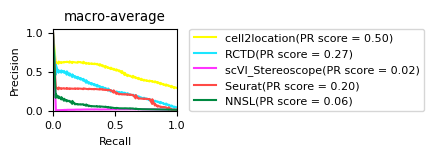

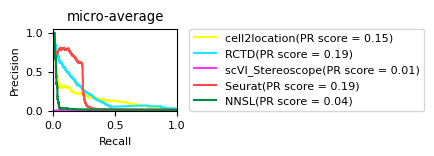

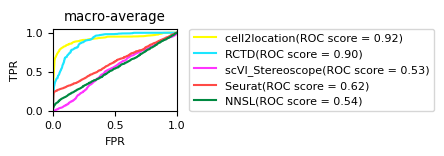

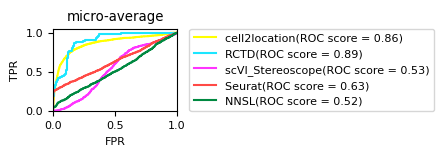

In [30]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (1.6, 1.3), 'font.size': 8}):
    
    for c in ['PR', 'ROC']:
        for m in ['macro', 'micro']:
            compare_precision_recall(pos_cell_count, results,
                                     method_title=names, 
                                     legend_loc=(1.1, 0),
                                     mode=m, curve=c,
                                     font_size=mpl.rcParams['font.size'], lw=1.5)
                                     #colors=['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal'])
            plt.tight_layout()
            plt.title(f'{m}-average')
#             plt.savefig(f'{fig_path}/{c}_comparison_all_{m}average.pdf', bbox_inches='tight')
            plt.show()

mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (6,5.5), 'font.size': 16}):
    plot_precision_recall(pos_cell_count, results[0], title=names[0])

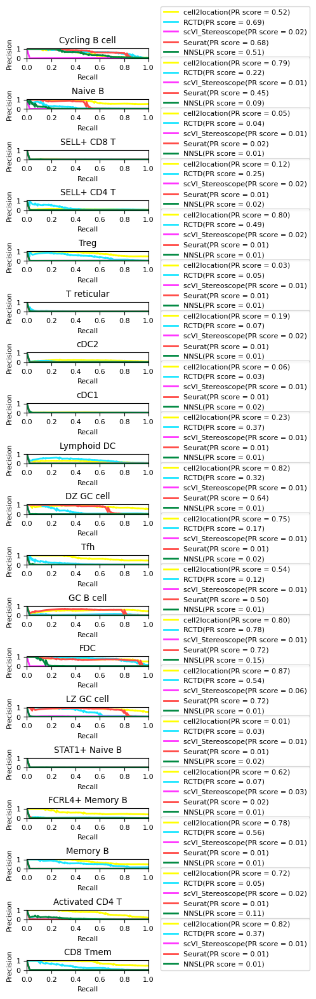

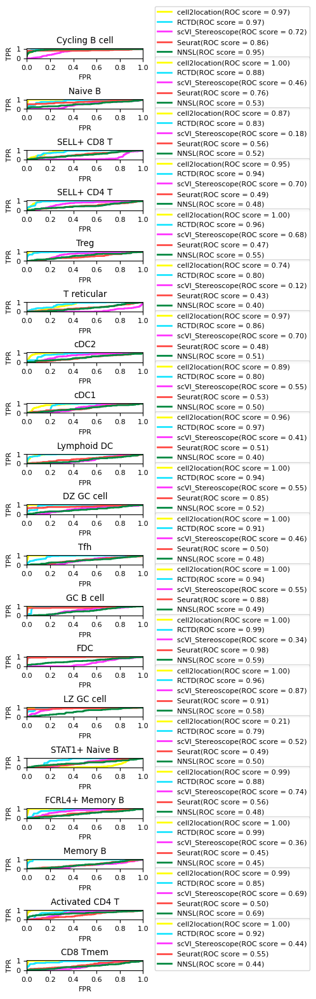

In [31]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (5,20), 'font.size': 8}):

    for c in ['PR', 'ROC']:
        for i, ct in enumerate(col_ind):

            plt.subplot(len(col_ind), 1, i+1)
            compare_precision_recall(pos_cell_count[:, np.isin(col_ind, ct)].reshape((pos_cell_count.shape[0], 1)), 
                                     [i[[ct]] for i in results],
                                     method_title=names, 
                                     legend_loc=(1.1, 0),
                                     curve=c, font_size=8,
                                     #colors=['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal']
                                    )
            plt.tight_layout()
            plt.title(f'{ct}')
#         plt.savefig(f'{fig_path}/{c}_comparison_all_cell_types.pdf', bbox_inches='tight')
        plt.show()

## Plot PR, ROC and spatial maps for selected cell types

In [32]:
col_ind

['Cycling B cell',
 'Naive B',
 'SELL+ CD8 T',
 'SELL+ CD4 T',
 'Treg',
 'T reticular',
 'cDC2',
 'cDC1',
 'Lymphoid DC',
 'DZ GC cell',
 'Tfh',
 'GC B cell',
 'FDC',
 'LZ GC cell',
 'STAT1+ Naive B',
 'FCRL4+ Memory B',
 'Memory B',
 'Activated CD4 T',
 'CD8 Tmem']

In [33]:
ct_sel = col_ind

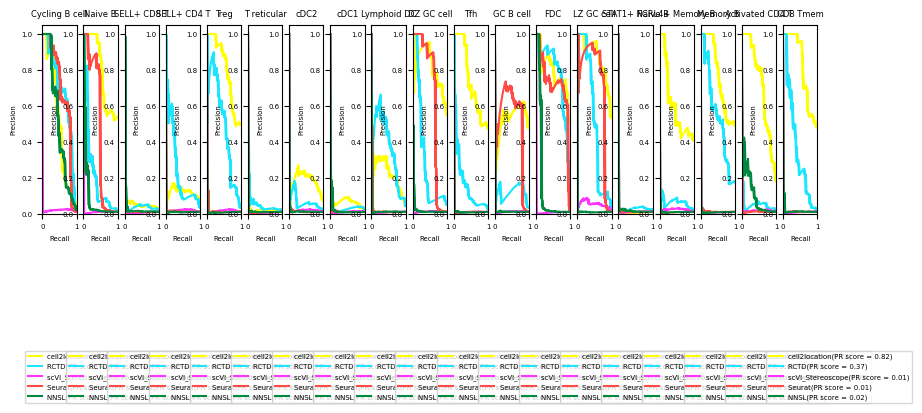

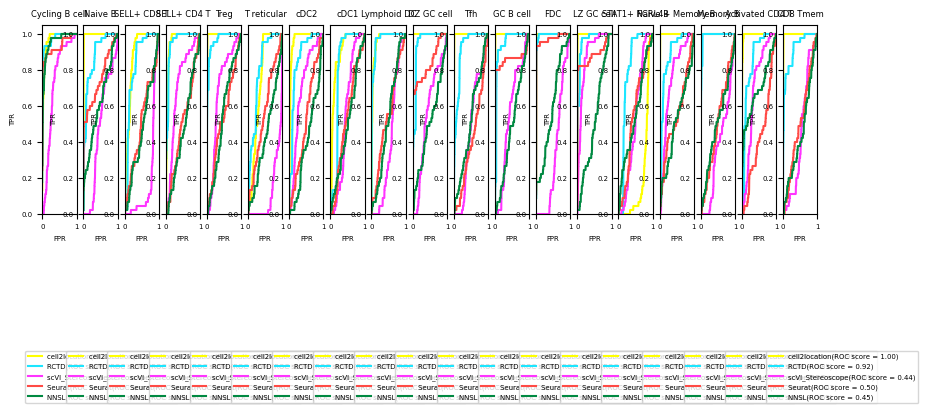

In [34]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (10, 3), 'font.size': 5}):

    for c in ['PR', 'ROC']:
        for i, ct in enumerate(ct_sel):

            plt.subplot(1, len(ct_sel), i+1)
            compare_precision_recall(pos_cell_count[:, np.isin(col_ind, ct)].reshape((pos_cell_count.shape[0], 1)), 
                                     [i[[ct]] for i in results],
                                     method_title=names, 
                                     legend_loc=(-0.5, -1.0),
                                     curve=c,
                                     font_size=mpl.rcParams['font.size'], lw=1.5,
                                     #colors=['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal']
                                    )
            plt.title(f'{ct}')
        plt.tight_layout()
        #plt.savefig(f'{fig_path}{c}_comparison_selected_{ct_sel}_cell_types.pdf', bbox_inches='tight')
        plt.show()

In [35]:
fig_path

'/nfs/team205/vk7/sanger_projects/collaborations/fetal_gut_mapping/results/c2l_v3_nonamortised_fulldata_epochs20k_lr0002_Adam_oxford_adult_paed_ref_signatures_N25_alphatest20/plots/figures/'

In [36]:
ct_sel = ['FDC']

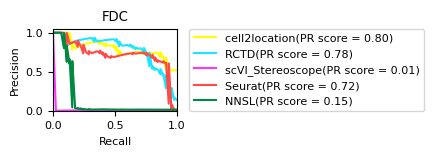

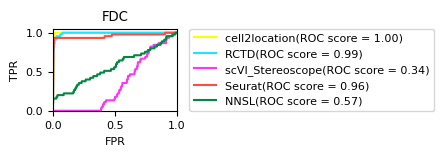

In [37]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (1.6, 1.3), 'font.size': 8}):

    for c in ['PR', 'ROC']:
        for i, ct in enumerate(ct_sel):

            plt.subplot(len(ct_sel), 1, i+1)
            compare_precision_recall(pos_cell_count[:, np.isin(col_ind, ct)].reshape((pos_cell_count.shape[0], 1)), 
                                     [i[[ct]] for i in results],
                                     method_title=names, 
                                     legend_loc=(1.1, 0),
                                     curve=c,
                                     font_size=mpl.rcParams['font.size'], lw=1.5,
                                     #colors=['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal']
                                    )
            plt.title(f'{ct}')
        plt.tight_layout()
#         plt.savefig(f'{fig_path}/{c}_comparison_selected_{ct_sel}_cell_types.pdf', bbox_inches='tight')
        plt.show()

## Bar plot for all cell types

In [38]:
results[0].values.sum(axis=1)

array([0.18824844, 0.14626431, 0.49692451, ..., 0.01935844, 0.05054771,
       0.13588335])

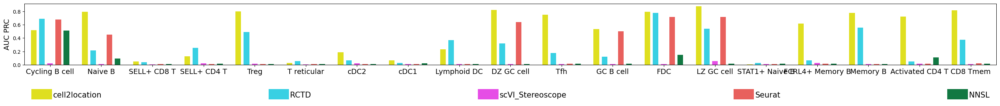

In [39]:
def get_stat_for_types_generic(cell_count, infer_cell_count, calculate_stat):
    max_val = np.array([cell_count.max(), infer_cell_count.values.max()]).max()
    if max_val < 1:
        max_val = 1
    
    types_data = {}
    for i, c in enumerate(infer_cell_count.columns): 
        types_data[c] = calculate_stat(cell_count[:,[i]], infer_cell_count.loc[:,[c]])
    return pd.DataFrame(types_data, index=[1])

from functools import partial
get_PR = lambda x, y: compute_precision_recall(x, y, mode='macro')[2]['averaged']

get_PR_df_short = partial(get_stat_for_types_generic, cell_count=pos_cell_count,
                          calculate_stat=get_PR)

pr_data = pd.concat([get_PR_df_short(infer_cell_count=df) for df in results])
pr_data['method'] = names
pr_data_melted = pd.melt(pr_data, id_vars=['method'], value_vars=pr_data.columns[:-1])

def change_width(ax, new_value) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        patch.set_x(patch.get_x() + diff * .5)

plt.figure(figsize=(27.2, 3.5))
g = sns.barplot(x="variable", y="value",
                hue="method",
                data=pr_data_melted, palette=sc.pl.palettes.default_102);
change_width(g, .11)
plt.xlabel('');
plt.ylabel('AUC PRC', size=14);
plt.xticks(size=14, ha='center');
lgnd = plt.legend(loc='center', bbox_to_anchor=(0, -0.65,  1, 0.3), mode='expand', ncol=6, 
           fontsize=15, frameon=False);
for handle in lgnd.legendHandles:
    handle.set_height(20)
    handle.set_width(40)
    handle.set_y(-4)
plt.tight_layout();

# plt.savefig(fig_path + '/barplot_by_category_with_label_all.pdf', bbox_inches='tight')

## Bar plot separating cell types by txn distinctiveness

(Treg                26.513507
 Activated CD4 T     26.513507
 CD8 Tmem            34.827352
 LZ GC cell          40.251828
 GC B cell           40.251828
 Tfh                 42.364630
 SELL+ CD8 T         45.663909
 SELL+ CD4 T         45.663909
 Naive B             50.410803
 Memory B            51.125023
 DZ GC cell          59.442900
 FCRL4+ Memory B     67.856671
 T reticular         83.719312
 cDC2               114.852030
 Cycling B cell     146.697020
 Lymphoid DC        179.910630
 cDC1               259.444202
 FDC                294.986501
 STAT1+ Naive B     631.208184
 Name: min_distance, dtype: float64,
 Activated CD4 T         26.513507
 Treg                    26.513507
 Th17                    33.821928
 Th1                     33.821928
 NK cell                 34.827352
                           ...    
 Stem cells             643.811706
 IgA plasma cell        683.287266
 Paneth                 791.022391
 Cycling plasma cell    826.955426
 IgG plasma cell        

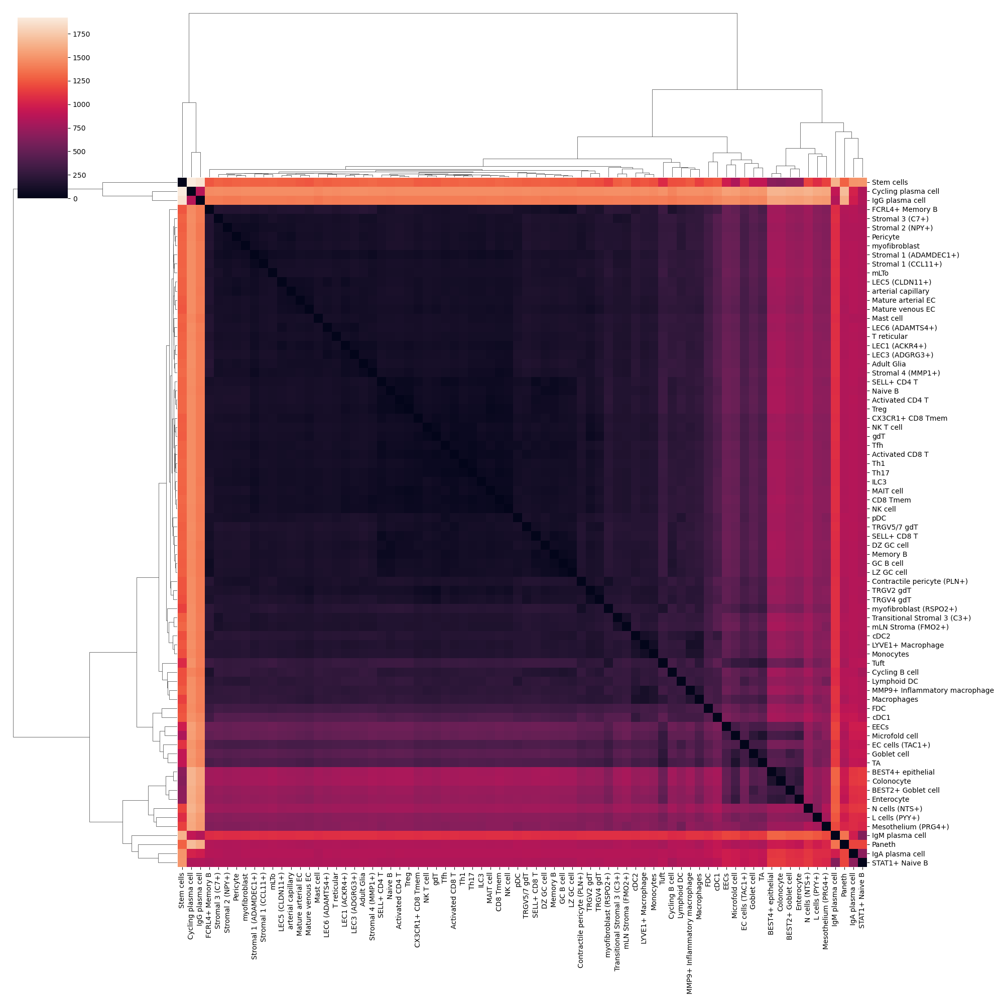

In [40]:
from scipy.spatial.distance import cdist

ct_dist = cdist(inf_aver.T, inf_aver.T, metric='euclidean')
ct_dist = pd.DataFrame(ct_dist, index=inf_aver.columns, columns=inf_aver.columns)

sns.clustermap(ct_dist, figsize=(20, 20))

distinctiveness = pd.DataFrame(np.array(
    [[ct_dist[c].sort_values()[1:4].mean() for c in ct_dist.columns],
     [ct_dist[c].sort_values()[1].mean() for c in ct_dist.columns]]
).T,
             index=ct_dist.columns, columns=['top3_average_distance', 'min_distance'])

distinctiveness['min_distance'][gold_standard_dict.keys()].sort_values(),\
distinctiveness['min_distance'].sort_values()

In [41]:
design = distinctiveness.loc[results[1].columns,:]
design['min_distance'].sort_values()

Treg                26.513507
Activated CD4 T     26.513507
CD8 Tmem            34.827352
LZ GC cell          40.251828
GC B cell           40.251828
Tfh                 42.364630
SELL+ CD8 T         45.663909
SELL+ CD4 T         45.663909
Naive B             50.410803
Memory B            51.125023
DZ GC cell          59.442900
FCRL4+ Memory B     67.856671
T reticular         83.719312
cDC2               114.852030
Cycling B cell     146.697020
Lymphoid DC        179.910630
cDC1               259.444202
FDC                294.986501
STAT1+ Naive B     631.208184
Name: min_distance, dtype: float64

In [42]:
design['is_high_density'] = 0
design.loc[design.index.isin([
    'Cycling B cell',
    'Naive B',
    'SELL+ CD8 T',
    'SELL+ CD4 T',
    'DZ GC cell',
    'GC B cell',
    'LZ GC cell'
]), 'is_high_density'] = 1

design['is_txn_fine'] = 1-np.digitize(design['min_distance'].values,
                                      [100]
                                      #np.histogram(distinctiveness['min_distance'].values, bins=4)[1]
                                     )
design, design['is_txn_fine'].value_counts(), design['is_high_density'].value_counts()

(                 top3_average_distance  min_distance  is_high_density  \
 Cycling B cell              156.280201    146.697020                1   
 Naive B                      53.121515     50.410803                1   
 SELL+ CD8 T                  58.701545     45.663909                1   
 SELL+ CD4 T                  47.436153     45.663909                1   
 Treg                         38.224660     26.513507                0   
 T reticular                  85.734901     83.719312                0   
 cDC2                        127.365635    114.852030                0   
 cDC1                        307.663544    259.444202                0   
 Lymphoid DC                 193.197893    179.910630                0   
 DZ GC cell                   66.442388     59.442900                1   
 Tfh                          47.682034     42.364630                0   
 GC B cell                    53.077841     40.251828                1   
 FDC                         301.22763

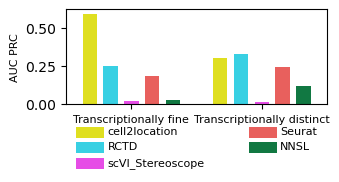

In [43]:
def get_stat_for_types_generic(cell_count, infer_cell_count, design, calculate_stat):
    design_loc = design.loc[infer_cell_count.columns,:]
    max_val = np.array([cell_count.max(), infer_cell_count.values.max()]).max()
    if max_val < 1:
        max_val = 1
    
    types_data = {}
    ind = design_loc['is_txn_fine'].values.astype(bool)
    types_data['Transcriptionally fine'] = calculate_stat(cell_count[:,ind], infer_cell_count.loc[:,ind])
    
    ind = ~ design_loc['is_txn_fine'].values.astype(bool)
    types_data['Transcriptionally distinct'] = calculate_stat(cell_count[:,ind], infer_cell_count.loc[:,ind])
    
    return pd.DataFrame(types_data, index=[1])

from functools import partial
get_PR = lambda x, y: compute_precision_recall(x, y, mode='macro')[2]['averaged']

get_PR_df_short = partial(get_stat_for_types_generic, cell_count=pos_cell_count,
                          design=design,
                          calculate_stat=get_PR)

pr_data = pd.concat([get_PR_df_short(infer_cell_count=df) for df in results])
pr_data['method'] = names
pr_data_melted = pd.melt(pr_data, id_vars=['method'], value_vars=pr_data.columns[:-1])

def change_width(ax, new_value) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        patch.set_x(patch.get_x() + diff * .5)

plt.figure(figsize=(3.4, 2.3))
g = sns.barplot(x="variable", y="value",
                hue="method",
                data=pr_data_melted, palette=sc.pl.palettes.default_102);
change_width(g, .11)
plt.xlabel('');
plt.ylabel('AUC PRC', size=8);
plt.xticks(size=8, ha='center');
lgnd = plt.legend(loc='center', bbox_to_anchor=(0, -0.5,  1, 0.1), mode='expand', ncol=2, 
           fontsize=8, frameon=False);
for handle in lgnd.legendHandles:
    handle.set_height(8)
    handle.set_width(20)
    handle.set_y(-3)
plt.tight_layout();

# plt.savefig(fig_path + '/barplot_by_category_txn_distinct_with_label.pdf', bbox_inches='tight')

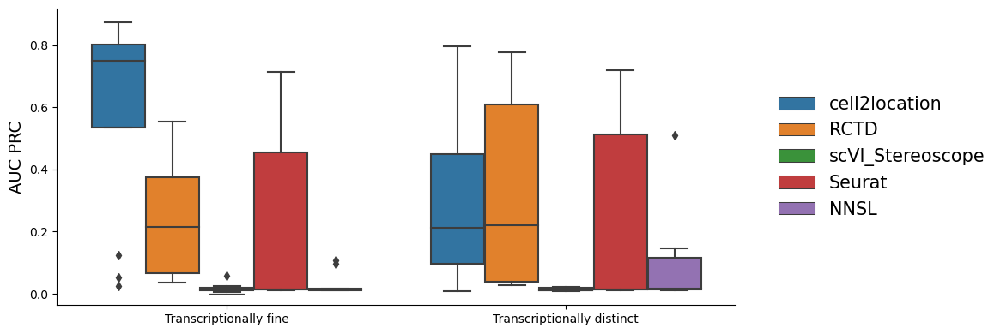

In [44]:
def get_stat_for_types_fine(cell_count, infer_cell_count, design, calculate_stat):
    design_loc = design.loc[infer_cell_count.columns,:]
    
    types_data = {}
    ind = design_loc['is_txn_fine'].values.astype(bool)
    types_data['Transcriptionally fine'] = calculate_stat(cell_count[:,ind], infer_cell_count.loc[:,ind])
    
    ind = ~ design_loc['is_txn_fine'].values.astype(bool)
    types_data['Transcriptionally distinct'] = calculate_stat(cell_count[:,ind], infer_cell_count.loc[:,ind])
    return pd.DataFrame(types_data, index=[1])

def remove_avg(d):
    d.pop('averaged')
    return d

get_PR_values = lambda x, y: [list(remove_avg(compute_precision_recall(x, y, mode='macro')[2]).values())]

get_PR_df_short = partial(get_stat_for_types_fine, cell_count=pos_cell_count,
                          design=design,
                          calculate_stat=get_PR_values)

dfs_detailed = []
for df, method in zip(results, names):
    df_detailed = get_PR_df_short(infer_cell_count=df)
    df_detailed = pd.melt(df_detailed, value_vars=df_detailed.columns)
    df_detailed = df_detailed.explode(column='value')
    df_detailed['method'] = method
    dfs_detailed.append(df_detailed)
    
pr_data_values = pd.concat(dfs_detailed)

plt.figure(figsize=(10.2, 4.5))
g = sns.boxplot(x="variable", y="value",
                hue="method",#ci='sd',
                data=pr_data_values);
change_width(g, .10)
plt.xlabel('');
plt.ylabel('AUC PRC', size=14);
plt.xticks(size=10, ha='center');
lgnd = plt.legend(loc='center left', bbox_to_anchor=(1.04, 0.5), ncol=1, 
           fontsize=15, frameon=False);

# for handle in lgnd.legendHandles:
#     handle.set_height(20)
#     handle.set_width(40)
#     handle.set_y(-4)
# plt.tight_layout();

g.spines['right'].set_visible(False)
g.spines['top'].set_visible(False)

# ax = plt.gca()
# ax.set_xticks(ax.get_xticks() + 0.4)
# plt.savefig(fig_path + '/barplot_by_category_with_label.pdf', bbox_inches='tight')

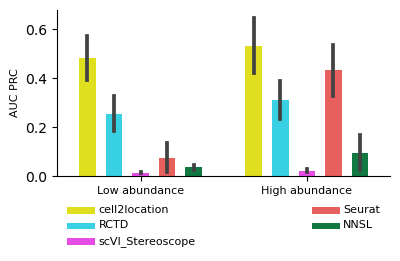

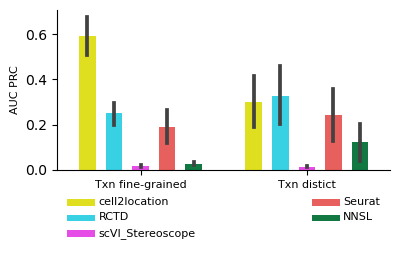

In [45]:
def remove_avg(d):
    d.pop('averaged')
    return d

def change_width(ax, new_value, shrink=0, shift=0):
    """
    Change width/position of barplots 
    """
    for patch, line in zip(ax.patches, ax.lines) :
        current_width = patch.get_width()
        diff = current_width - new_value

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        x_orig = patch.get_x()
        patch.set_x(x_orig + diff * .5)
        x_orig = patch.get_x()
        patch.set_x(x_orig + shrink * (round(x_orig) - x_orig))
        
        line.set_xdata(line.get_xdata() + shrink * (np.round(x_orig) - x_orig))

get_PR_values = lambda x, y: list(remove_avg(compute_precision_recall(x.values, y, mode='macro')[2]).values())

get_PR_df_short = partial(get_stat_for_types_generic, cell_count=pos_cell_count_df,
                          design=design,
                          calculate_stat=get_PR_values)

dfs_detailed = []
for df, method in zip(results, names):
    df_detailed = pd.DataFrame({'value': get_PR_values(pos_cell_count_df, df)})
    df_detailed['cell_type'] = df.columns
    df_detailed['is_high_density'] = design['is_high_density'][df.columns].values
    df_detailed['is_txn_fine'] = design['is_txn_fine'][df.columns].values
    df_detailed['method'] = method
    
    dfs_detailed.append(df_detailed)
pr_data_values = pd.concat(dfs_detailed)

pr_data_values['Fig5_abundance_categories'] = ''
pr_data_values.loc[pr_data_values['is_high_density'] == 0, 'Fig5_abundance_categories'] = \
'Low abundance'
pr_data_values.loc[pr_data_values['is_high_density'] == 1, 'Fig5_abundance_categories'] = \
'High abundance'
pr_data_values['Fig5_abundance_categories'] = pr_data_values['Fig5_abundance_categories'].astype('category')
pr_data_values['Fig5_abundance_categories'] = pr_data_values['Fig5_abundance_categories'].cat.reorder_categories([
    'Low abundance', 'High abundance'
])

pr_data_values['Fig5_txn_categories'] = ''
pr_data_values.loc[pr_data_values['is_txn_fine'] == 1, 'Fig5_txn_categories'] = \
'Txn fine-grained'
pr_data_values.loc[pr_data_values['is_txn_fine'] == 0, 'Fig5_txn_categories'] = \
'Txn distict'
pr_data_values['Fig5_txn_categories'] = pr_data_values['Fig5_txn_categories'].astype('category')
pr_data_values['Fig5_txn_categories'] = pr_data_values['Fig5_txn_categories'].cat.reorder_categories([
    'Txn fine-grained', 'Txn distict'
])

def plot_boxplot_prc(x, y="value", n_leged_col=6):
    #g = sns.boxplot(x=x, y=y,
    #                hue="method",
    #                data=pr_data_values, palette=sc.pl.palettes.default_102);
    g = sns.barplot(x=x, y=y,
                    hue="method", ci=68,
                    data=pr_data_values, palette=sc.pl.palettes.default_102);
    
    change_width(g, .10)
    #change_width(g, .04, shrink=0.55, shift=0.01)
    
    plt.xlabel('');
    plt.ylabel('AUC PRC', size=8);
    plt.xticks(size=8, ha='center');
    # lgnd = plt.legend(loc='center left', bbox_to_anchor=(1.04, 0.5), ncol=1, 
    #            fontsize=15, frameon=False);

    lgnd = plt.legend(loc='center', bbox_to_anchor=(0, -0.45,  1, 0.3), 
                      mode='expand', ncol=n_leged_col, 
                      fontsize=8, frameon=False);

    for handle in lgnd.legendHandles:
         handle.set_height(5)
         handle.set_width(20)
         handle.set_y(-1)
    # plt.tight_layout();

    g.spines['right'].set_visible(False)
    g.spines['top'].set_visible(False)
    plt.tight_layout();

    # ax = plt.gca()
    # ax.set_xticks(ax.get_xticks() + 0.4)
    # plt.savefig(fig_path + '/barplot_by_category_with_label.pdf', bbox_inches='tight')
    
plt.figure(figsize=(4.1, 2.88))
plot_boxplot_prc('Fig5_abundance_categories', n_leged_col=2)
plt.savefig(fig_path + '/barplot_Fig5_abundance_categories.pdf', bbox_inches='tight')
plt.show()

plt.figure(figsize=(4.1, 2.8))
plot_boxplot_prc('Fig5_txn_categories', n_leged_col=2)
plt.savefig(fig_path + '/barplot_Fig5_txn_categories.pdf', bbox_inches='tight')
plt.show()

## Bar plot for selected cell types

In [46]:
ct_sel = ['SELL+ CD4 T', 'Naive B']

In [47]:
[f'{m}_{ct}' for ct in ct_sel for m in names]

['cell2location_SELL+ CD4 T',
 'RCTD_SELL+ CD4 T',
 'scVI_Stereoscope_SELL+ CD4 T',
 'Seurat_SELL+ CD4 T',
 'NNSL_SELL+ CD4 T',
 'cell2location_Naive B',
 'RCTD_Naive B',
 'scVI_Stereoscope_Naive B',
 'Seurat_Naive B',
 'NNSL_Naive B']

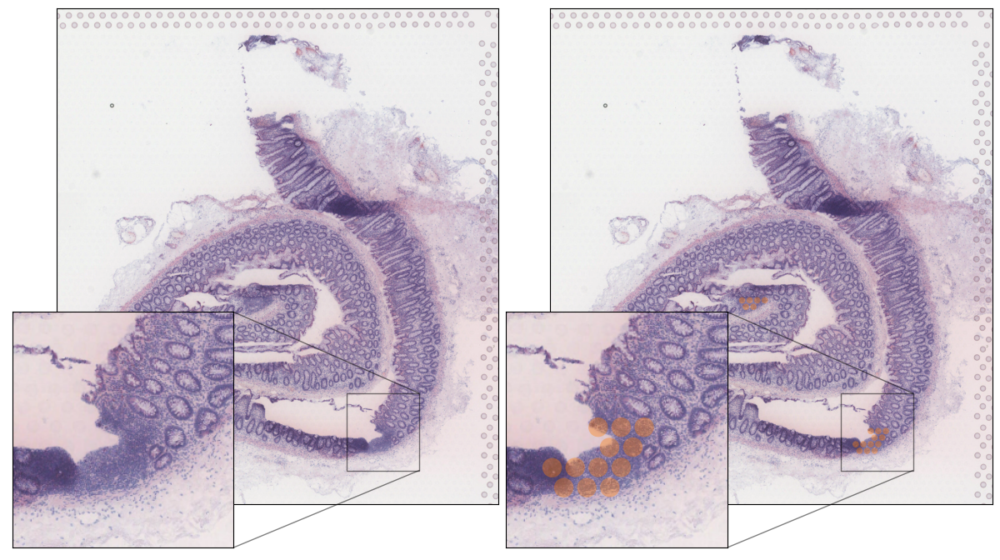

In [48]:
ct_subset = ['FCRL4+ Memory B', 'Tfh', 'CD8 Tmem', 'FDC']
slide_tmp = slide[slide.obs['Annotation'] == 'Lymphoid_structure']
with mpl.rc_context({'font.weight': 'normal'}):
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 8))
    for n_ct, alpha in enumerate([0, 0.38]):
        sc.pl.spatial(slide_tmp, cmap='magma',
                color=['Annotation'],
                size=1.3, img_key='hires', alpha_img=0.9, alpha=alpha,
                frameon=True, legend_fontsize=20, wspace=0.15, na_color=(0,0,0,0),
                vmin=0, vmax='p99.5', ax=axs[n_ct], show=False, legend_loc=None, crop_coord=np.array([496, 1872, 131, 1675])/list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'])
        axs[n_ct].set_xlabel('')
        axs[n_ct].set_ylabel('')
        axs[n_ct].set_title('')

        axins = axs[n_ct].inset_axes([-0.1, -0.1, 0.5, 0.5])

        sc.pl.spatial(slide_tmp, cmap='magma',
            color=['Annotation'],
            size=1.3, img_key='hires', alpha_img=0.9, alpha=alpha,
            frameon=True, legend_fontsize=20, wspace=0.15,
            vmin=0, vmax='p99.5', ax=axins, show=False, legend_loc=None)
        axins.set_xlabel('')
        axins.set_ylabel('')
        axins.set_title('')

        x1, x2, y1, y2 = 1400, 1625, 1330, 1570
        axins.set_xlim(x1, x2)
        axins.set_ylim(y1, y2)
        axs[n_ct].indicate_inset_zoom(axins, edgecolor="black")
        axins.invert_yaxis()
#         axins.collections[-1].colorbar.remove()


    plt.tight_layout()
# plt.savefig(f'{fig_path}/5C_only_lymphoid.pdf', bbox_inches='tight')

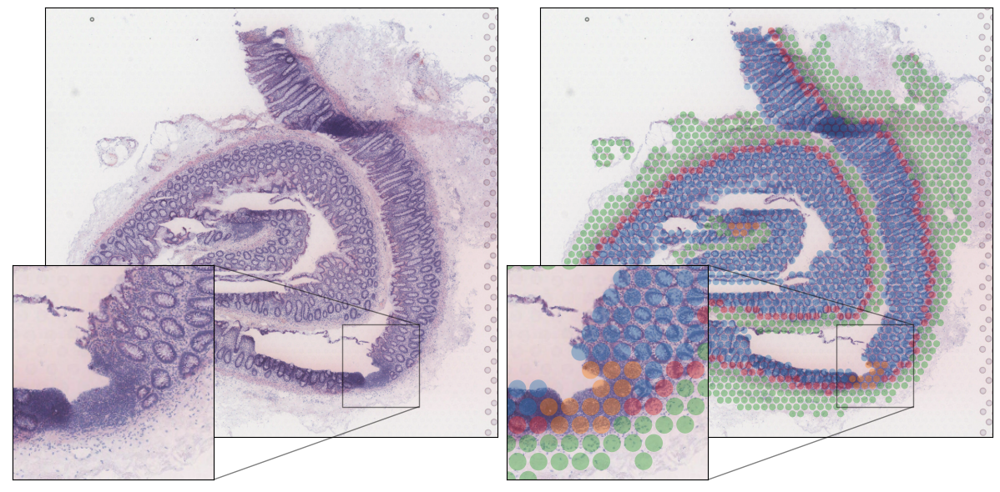

In [49]:
ct_subset = ['FCRL4+ Memory B', 'Tfh', 'CD8 Tmem', 'FDC']

slide[slide.obs['Annotation'] == 'Lymphoid_structure']

with mpl.rc_context({'font.weight': 'normal'}):
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 8))
    for n_ct, alpha in enumerate([0, 0.38]):
        sc.pl.spatial(slide, cmap='magma',
                color=['Annotation'],
                size=1.3, img_key='hires', alpha_img=0.9, alpha=alpha,
                frameon=True, legend_fontsize=2, wspace=0.15,
                vmin=0, vmax='p99.5', ax=axs[n_ct], show=False, legend_loc=None)
        axs[n_ct].set_xlabel('')
        axs[n_ct].set_ylabel('')
        axs[n_ct].set_title('')

        axins = axs[n_ct].inset_axes([-0.1, -0.1, 0.5, 0.5])

        sc.pl.spatial(slide, cmap='magma',
            color=['Annotation'],
            size=1.3, img_key='hires', alpha_img=0.9, alpha=alpha,
            frameon=True, legend_fontsize=2, wspace=0.15,
            vmin=0, vmax='p99.5', ax=axins, show=False, legend_loc=None)
        axins.set_xlabel('')
        axins.set_ylabel('')
        axins.set_title('')

        x1, x2, y1, y2 = 1400, 1625, 1330, 1570
        axins.set_xlim(x1, x2)
        axins.set_ylim(y1, y2)
        axs[n_ct].indicate_inset_zoom(axins, edgecolor="black")
        axins.invert_yaxis()
#         axins.collections[-1].colorbar.remove()


    plt.tight_layout()
# plt.savefig(f'{fig_path}/5C_not_only_lymphoid.pdf', bbox_inches='tight')

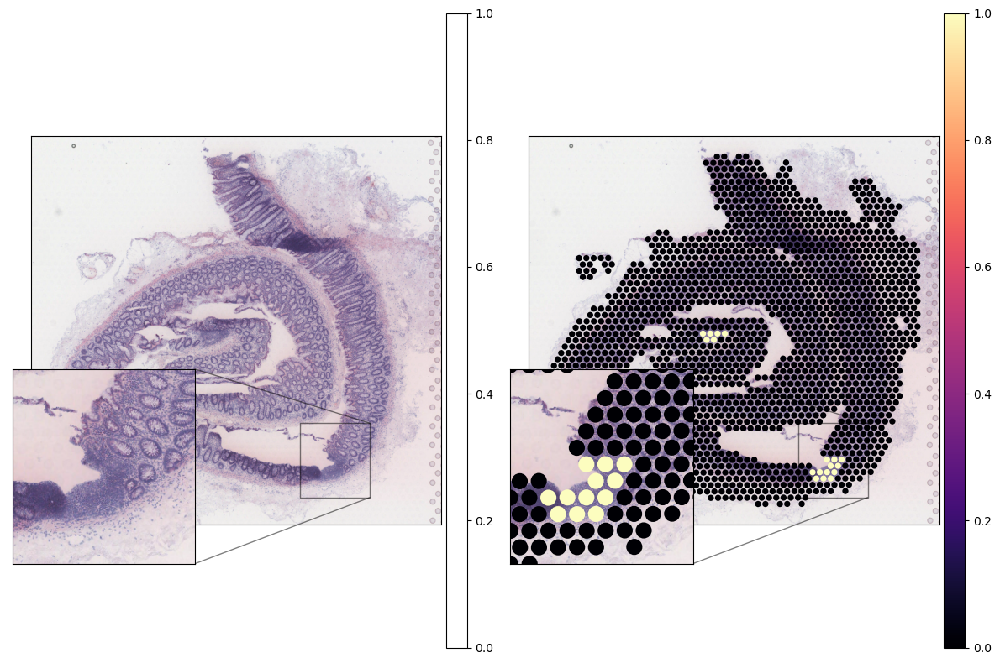

In [50]:
ct_subset = ['FCRL4+ Memory B', 'Tfh', 'CD8 Tmem', 'FDC']

slide.obs['is_LN'] = [1 if i else 0 for i in slide.obs['Annotation'] == 'Lymphoid_structure']

with mpl.rc_context({'font.weight': 'normal'}):
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 8))
    for n_ct, alpha in enumerate([0, 1]):
        sc.pl.spatial(slide, cmap='magma',
                color=['is_LN'],
                size=1.3, img_key='hires', alpha_img=0.9, alpha=alpha,
                frameon=True, legend_fontsize=2, wspace=0.15,
                vmin=0, vmax='p99.5', ax=axs[n_ct], show=False, legend_loc=None)
        axs[n_ct].set_xlabel('')
        axs[n_ct].set_ylabel('')
        axs[n_ct].set_title('')
#         if alpha == 0:
#             axins.collections[-1].colorbar.remove()

        axins = axs[n_ct].inset_axes([-0.1, -0.1, 0.5, 0.5])

        sc.pl.spatial(slide, cmap='magma',
            color=['is_LN'],
            size=1.3, img_key='hires', alpha_img=0.9, alpha=alpha,
            frameon=True, legend_fontsize=2, wspace=0.15,
            vmin=0, vmax='p99.5', ax=axins, show=False, legend_loc=None)
        axins.set_xlabel('')
        axins.set_ylabel('')
        axins.set_title('')

        x1, x2, y1, y2 = 1400, 1625, 1330, 1570
        axins.set_xlim(x1, x2)
        axins.set_ylim(y1, y2)
        axs[n_ct].indicate_inset_zoom(axins, edgecolor="black")
        axins.invert_yaxis()
        axins.collections[-1].colorbar.remove()


    plt.tight_layout()
# plt.savefig(f'{fig_path}/5C_not_only_lymphoid_contrast.pdf', bbox_inches='tight')

Trying to set attribute `.uns` of view, copying.


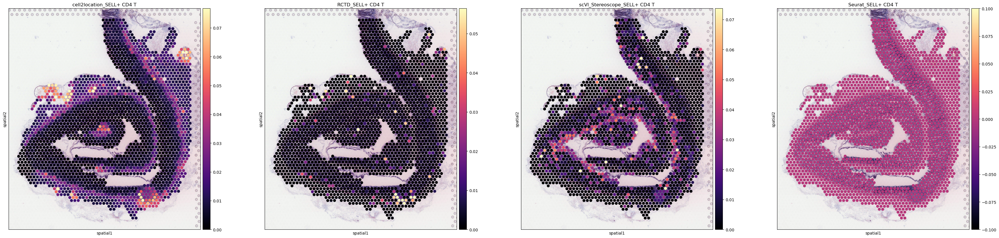

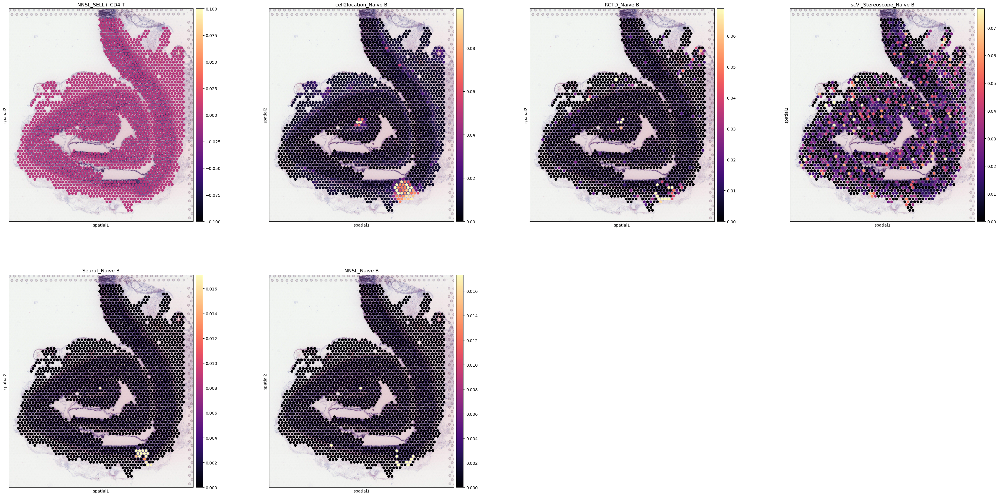

In [51]:
col_list=[f'{m}_{ct}' for ct in ct_sel for m in names]

slide = select_slide(adata_vis, 'A1')
with mpl.rc_context({'axes.facecolor':  'black',
                            'figure.figsize': [10, 10]}):
                
    fig=sc.pl.spatial(slide, cmap='magma',
                  color=col_list[0:4], ncols=4, 
                  size=1.3, img_key='hires', 
                  alpha_img=1, alpha=1,
                  frameon=True, legend_fontsize=20,
                  #crop_coord=crop_x + [crop_y[0]] + [crop_y[1]],
                  vmin=0, vmax='p99.5',
                  return_fig=True
                  #palette=sc.pl.palettes.default_102
                 )
    #add_rectangle_to_fig(fig, [coord_small[0], coord_small[1], 
    #                               img_shape[1] - coord_small[2] + (img_shape[1] - crop_y[0]), 
    #                               img_shape[1] - coord_small[3] + (img_shape[1] - crop_y[0])],
    #                         edgecolor='white', linestyle='--', linewidth=5)
    #plt.savefig(f'{fig_path}benchmark_all_methods_selected_cell_types_1.pdf',
    #                bbox_inches='tight', facecolor='white')
    
    fig=sc.pl.spatial(slide, cmap='magma',
                  color=col_list[4:], ncols=4, 
                  size=1.3, img_key='hires', 
                  alpha_img=1, alpha=1,
                  frameon=True, legend_fontsize=20,
                  #crop_coord=crop_x + [crop_y[0]] + [crop_y[1]],
                  vmin=0, vmax='p99.5',
                  return_fig=True
                  #palette=sc.pl.palettes.default_102
                 )
    #add_rectangle_to_fig(fig, [coord_small[0], coord_small[1], 
    #                               img_shape[1] - coord_small[2] + (img_shape[1] - crop_y[0]), 
    #                               img_shape[1] - coord_small[3] + (img_shape[1] - crop_y[0])],
    #                         edgecolor='white', linestyle='--', linewidth=5)
    #plt.savefig(f'{fig_path}benchmark_all_methods_selected_cell_types_2.pdf',
    #                bbox_inches='tight', facecolor='white')

In [52]:
str(sc.settings.figdir)+'/' == fig_path

True

In [53]:
fig_path

'/nfs/team205/vk7/sanger_projects/collaborations/fetal_gut_mapping/results/c2l_v3_nonamortised_fulldata_epochs20k_lr0002_Adam_oxford_adult_paed_ref_signatures_N25_alphatest20/plots/figures/'

In [54]:
list(slide.obs.columns)

['in_tissue',
 'array_row',
 'array_col',
 'sample',
 'n_genes_by_counts',
 'log1p_n_genes_by_counts',
 'total_counts',
 'log1p_total_counts',
 'pct_counts_in_top_50_genes',
 'pct_counts_in_top_100_genes',
 'pct_counts_in_top_200_genes',
 'pct_counts_in_top_500_genes',
 'mt_frac',
 'Annotation',
 '_scvi_batch',
 '_scvi_labels',
 '_scvi_local_l_mean',
 '_scvi_local_l_var',
 '_indices',
 'Activated CD4 T',
 'Activated CD8 T',
 'Adult Glia',
 'BEST2+ Goblet cell',
 'BEST4+ epithelial',
 'CD8 Tmem',
 'CX3CR1+ CD8 Tmem',
 'Colonocyte',
 'Contractile pericyte (PLN+)',
 'Cycling B cell',
 'Cycling plasma cell',
 'DZ GC cell',
 'EC cells (TAC1+)',
 'EECs',
 'Enterocyte',
 'FCRL4+ Memory B',
 'FDC',
 'GC B cell',
 'Goblet cell',
 'ILC3',
 'IgA plasma cell',
 'IgG plasma cell',
 'IgM plasma cell',
 'L cells (PYY+)',
 'LEC1 (ACKR4+)',
 'LEC3 (ADGRG3+)',
 'LEC5 (CLDN11+)',
 'LEC6 (ADAMTS4+)',
 'LYVE1+ Macrophage',
 'LZ GC cell',
 'Lymphoid DC',
 'MAIT cell',
 'MMP9+ Inflammatory macrophage',
 'Mac

Trying to set attribute `.uns` of view, copying.


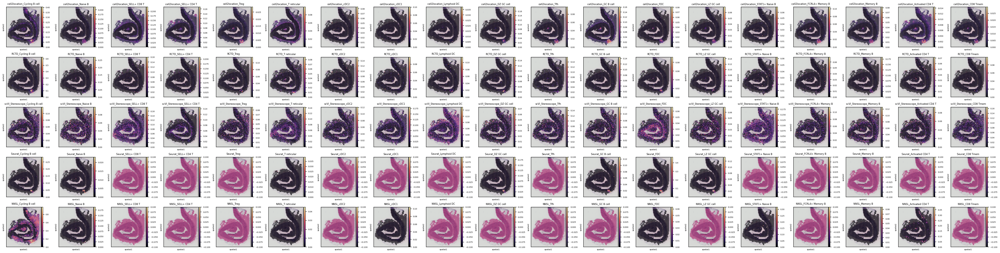

In [55]:
ct_sel = col_ind

col_list=[f'{m}_{ct}' for m in names for ct in ct_sel]

slide = select_slide(adata_vis, 'A1')
with mpl.rc_context({'axes.facecolor':  'black', 'font.size': 5,
                            'figure.figsize': [2, 2]}):
                
    sc.pl.spatial(slide, cmap='magma',
                    color=col_list, ncols=19, #show=False,
                    #library_id=s,
                    size=1.3, img_key='hires', alpha_img=0.9, alpha=1,
                    frameon=True, legend_fontsize=3, wspace=0.15,
                    vmin=0, vmax='p99.99')

Trying to set attribute `.uns` of view, copying.


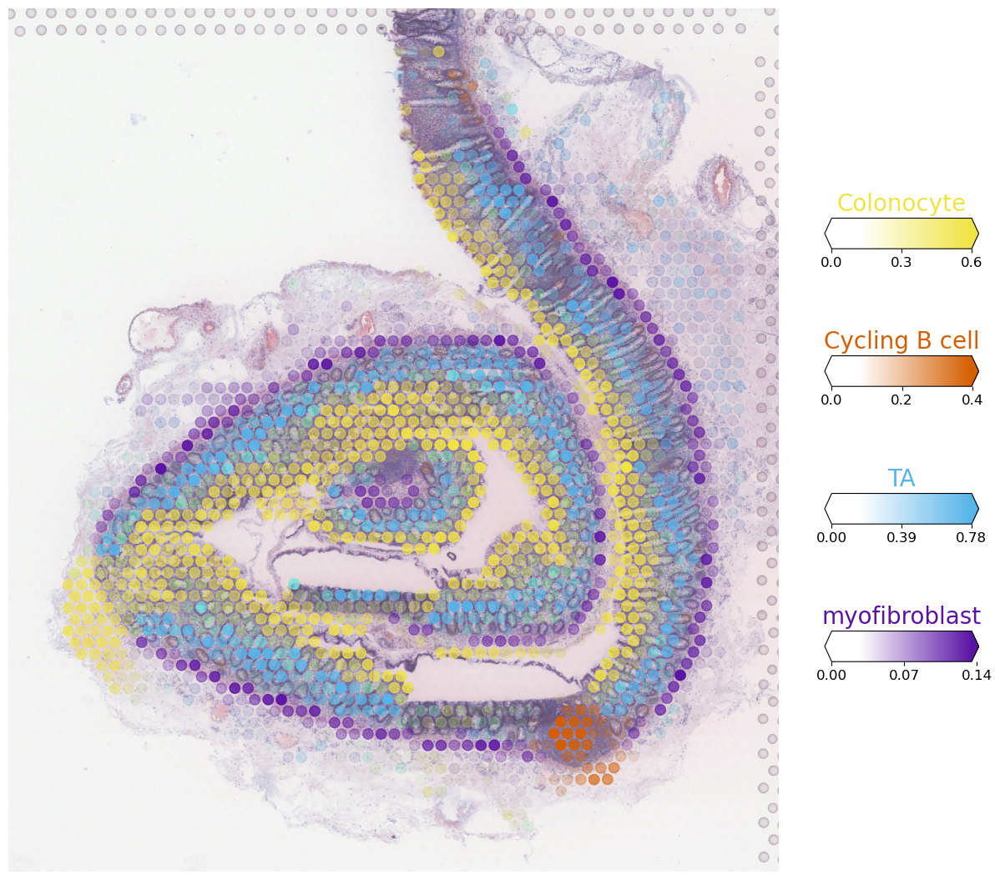

In [56]:
from cell2location.plt.mapping_video import plot_spatial

# select up to 6 clusters
sel_clust = ['Colonocyte', 'Cycling B cell', 'TA', 'myofibroblast']
sel_clust_col = ['cell2location_' + str(i) for i in sel_clust]

slide = select_slide(adata_vis, 'A1')

with mpl.rc_context({'figure.figsize': (15, 15), 'font.weight': 'normal'}):
    fig = plot_spatial(slide.obs[sel_clust_col], labels=sel_clust,
                  coords=slide.obsm['spatial'] \
                          * list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'],
                  show_img=True, img_alpha=0.8, max_color_quantile=0.9995, crop_x=(496, 1872), crop_y=(131, 1675),
                  style='fast', # fast or dark_background
                  img=list(slide.uns['spatial'].values())[0]['images']['hires'], alpha_scaling=1,
                  circle_diameter=8.88, colorbar_position='right', white_spacing=20, colorbar_shape={'vertical_gaps': 1.5, 
                                                                                                 'horizontal_gaps': 0.1,
                                'width': 0.2, 'height': 0.2}, reorder_cmap=(0, 1, 2, 4))
    
plt.savefig(f'{fig_path}/5C_multicolor_cropped.pdf', bbox_inches='tight')

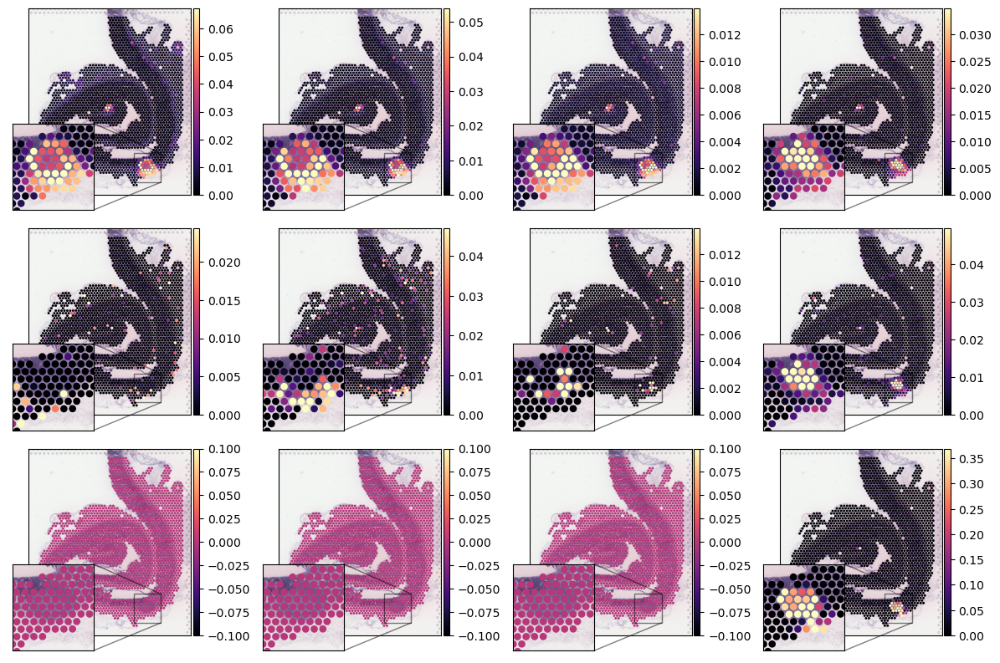

In [57]:
ct_subset = ['FCRL4+ Memory B', 'Tfh', 'CD8 Tmem', 'FDC']

with mpl.rc_context({'font.weight': 'normal'}):
    fig, axs = plt.subplots(nrows=len(names[:2] + names[-2:-1]), ncols=len(ct_subset), figsize=(12, 8))
    for n_name, name in enumerate(names[:2] + names[-2:-1]):
        for n_ct, ct in enumerate(ct_subset):
            sc.pl.spatial(slide, cmap='magma',
                    color=f'{name}_{ct}',
                    size=1.3, img_key='hires', alpha_img=0.9, alpha=1,
                    frameon=True, legend_fontsize=2, wspace=0.15,
                    vmin=0, vmax='p99.5', ax=axs[n_name, n_ct], show=False)
            axs[n_name, n_ct].set_xlabel('')
            axs[n_name, n_ct].set_ylabel('')
            axs[n_name, n_ct].set_title('')

            axins = axs[n_name, n_ct].inset_axes([-0.1, -0.1, 0.5, 0.5])

            sc.pl.spatial(slide, cmap='magma',
                color=f'{name}_{ct}',
                size=1.3, img_key='hires', alpha_img=0.9, alpha=1,
                frameon=True, legend_fontsize=2, wspace=0.15,
                vmin=0, vmax='p99.5', ax=axins, show=False, legend_loc=None)
            axins.set_xlabel('')
            axins.set_ylabel('')
            axins.set_title('')

            x1, x2, y1, y2 = 1400, 1625, 1330, 1570
            axins.set_xlim(x1, x2)
            axins.set_ylim(y1, y2)
            axs[n_name, n_ct].indicate_inset_zoom(axins, edgecolor="black")
            axins.invert_yaxis()
            axins.collections[-1].colorbar.remove()


    plt.tight_layout()
plt.savefig(f'{fig_path}/5D_with_zoom_ins.pdf', bbox_inches='tight')

Trying to set attribute `.uns` of view, copying.


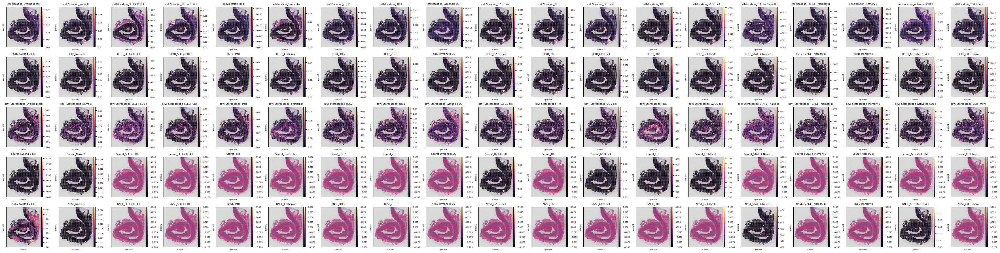

In [58]:
ct_sel = col_ind

col_list=[f'{m}_{ct}' for m in names for ct in ct_sel]

slide = select_slide(adata_vis, 'A1')
with mpl.rc_context({'axes.facecolor':  'black', 'font.size': 5,
                            'figure.figsize': [2, 2]}):
                
    sc.pl.spatial(slide, cmap='magma',
                    color=col_list, ncols=19, #show=False,
                    #library_id=s,
                    size=1.3, img_key='hires', alpha_img=0.9, alpha=1,
                    frameon=True, legend_fontsize=3, wspace=0.15,
                    vmin=0, vmax='p99.5', save=f'benchmark_all_methods_all_cell_types_A1.pdf'
                 )

Trying to set attribute `.uns` of view, copying.


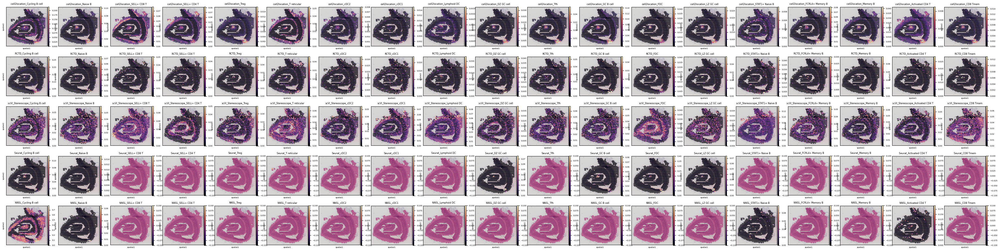

In [59]:
ct_sel = col_ind

col_list=[f'{m}_{ct}' for m in names for ct in ct_sel]

slide = select_slide(adata_vis, 'A2')
with mpl.rc_context({'axes.facecolor':  'black', 'font.size': 5,
                            'figure.figsize': [2, 2]}):
                
    sc.pl.spatial(slide, cmap='magma',
                    color=col_list, ncols=19, #show=False,
                    #library_id=s,
                    size=1.3, img_key='hires', alpha_img=0.9, alpha=1,
                    frameon=True, legend_fontsize=3, wspace=0.15,
                    vmin=0, vmax='p99.5', save=f'benchmark_all_methods_all_cell_types_A2.pdf'
                 )

## Box plot separating cell types by txn distinctiveness

Modules and their versions used for this analysis

In [60]:
import sys
for module in sys.modules:
    try:
        print(module,sys.modules[module].__version__)
    except:
        try:
            if  type(sys.modules[module].version) is str:
                print(module,sys.modules[module].version)
            else:
                print(module,sys.modules[module].version())
        except:
            try:
                print(module,sys.modules[module].VERSION)
            except:
                pass


sys 3.7.10 | packaged by conda-forge | (default, Feb 19 2021, 16:07:37) 
[GCC 9.3.0]
ipykernel 5.5.3
ipykernel._version 5.5.3
json 2.0.9
re 2.2.1
IPython 7.22.0
IPython.core.release 7.22.0
logging 0.5.1.2
zlib 1.0
traitlets 5.0.5
traitlets._version 5.0.5
argparse 1.1
ipython_genutils 0.2.0
ipython_genutils._version 0.2.0
platform 1.0.8
IPython.core.crashhandler 7.22.0
pygments 2.8.1
pexpect 4.8.0
ptyprocess 0.7.0
decorator 5.0.6
pickleshare 0.7.5
backcall 0.2.0
sqlite3 2.6.0
sqlite3.dbapi2 2.6.0
_sqlite3 2.6.0
prompt_toolkit 3.0.18
wcwidth 0.2.5
jedi 0.18.0
parso 0.8.2
colorama 0.4.4
ctypes 1.1.0
_ctypes 1.1.0
IPython.core.magics.code 7.22.0
urllib.request 3.7
jupyter_client 6.1.12
jupyter_client._version 6.1.12
zmq 22.0.3
zmq.backend.cython 40304
zmq.backend.cython.constants 40304
zmq.sugar 22.0.3
zmq.sugar.constants 40304
zmq.sugar.version 22.0.3
jupyter_core 4.7.1
jupyter_core.version 4.7.1
tornado 6.1
_curses b'2.2'
dateutil 2.8.1
dateutil._version 2.8.1
six 1.15.0
decimal 1.70
_de